# Modeling semantic change using word embeddings

This tutorial shows how word embeddings and some linear algebra can be used to model the meaning of large corpora of text and how this meaning changes over time. The method is derived from a [2016 paper](https://arxiv.org/pdf/1605.09096.pdf) by William Hamilton, Jure Leskovec, and Dan Jurafsky at Stanford. This tutorial is partially based on code from Hamilton's [Github repository](https://github.com/williamleif/histwords), some additional functions written by [Ryan Heuser](https://gist.github.com/quadrismegistus/09a93e219a6ffc4f216fb85235535faf), and a tutorial on word2vec by [George Berry](https://github.com/socdyn/tutorials/blob/master/w2v/w2v_tutorial.ipynb).

In [1]:
import glob
import json
import gensim
import math
from collections import defaultdict
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.rcParams["figure.figsize"] = (64,48)

In [2]:
import logging

logging.basicConfig(
    format='%(asctime)s : %(levelname)s : %(message)s',
    level=logging.INFO
)

## Loading data

The compressed file `comments.tar.gz` contains the preprocessed text data that is used in this analysis. The contents of this file must be extracted and then loading into Python.

In [6]:
!tar -zxvf comments.tar.gz

x trump_comments/
x trump_comments/0.json
x trump_comments/1.json
x trump_comments/2.json
x trump_comments/3.json
x trump_comments/4.json


In [4]:
import glob
import json
files = glob.glob('trump_comments/*')
files

['trump_comments/0.json',
 'trump_comments/1.json',
 'trump_comments/2.json',
 'trump_comments/3.json',
 'trump_comments/4.json']

In [5]:
comments = []
for i in range(0, len(files)):
    with open(files[i], 'r') as f:
        data = json.load(f)
        comments.append(data)

In [6]:
print(comments[0][0])

['this', 'country', 'needs', 'to', 'be', 'ran', 'like', 'a', 'business']


In [7]:
print(comments[0][100000])

['donald', 'trump', 'what', 'is', 'your', 'answer', 'to', 'how', 'can', 'we', 'get', 'back', 'on', 'track', 'with', 'so', 'many', 'stupid', 'people', 'in', 'leadership', 'roles']


# Part One: Learning the word embeddings

These lists can now be directly passed to `gensim`, the package that implements the Word2Vec method which will be used to construct the embeddings. Each list contains one million comments that have been set to have had punctuation removed, words set to lower case, and been tokenized. The function below iterates through these lists and creates a word embedding for each sample by calling the Word2Vec function. The embeddings are then stored in a new list called `models`.

To estimate the embeddings I follow Hamilton et al. (2016) and use the skip-gram model with negative sampling. 

In [40]:
%%time

models = []

for c in comments:
    
    w2v_model = gensim.models.Word2Vec(
        c,
        sg=1,
        iter=10,
        seed=42,
        workers=4,
        size=300,
        sample=1e-4,
        window=4,
        min_count=5,
        max_vocab_size=100000
    )
    
    models.append(w2v_model)

2017-11-09 12:12:27,149 : INFO : collecting all words and their counts
2017-11-09 12:12:27,150 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2017-11-09 12:12:27,203 : INFO : PROGRESS: at sentence #10000, processed 230953 words, keeping 14913 word types
2017-11-09 12:12:27,260 : INFO : PROGRESS: at sentence #20000, processed 460785 words, keeping 21394 word types
2017-11-09 12:12:27,328 : INFO : PROGRESS: at sentence #30000, processed 698277 words, keeping 26489 word types
2017-11-09 12:12:27,390 : INFO : PROGRESS: at sentence #40000, processed 924659 words, keeping 30587 word types
2017-11-09 12:12:27,453 : INFO : PROGRESS: at sentence #50000, processed 1155749 words, keeping 34606 word types
2017-11-09 12:12:27,513 : INFO : PROGRESS: at sentence #60000, processed 1381025 words, keeping 38139 word types
2017-11-09 12:12:27,579 : INFO : PROGRESS: at sentence #70000, processed 1620056 words, keeping 41353 word types
2017-11-09 12:12:27,646 : INFO : PROGRESS: 

2017-11-09 12:12:31,815 : INFO : pruned out 53243 tokens with count <=3 (before 100001, after 46758)
2017-11-09 12:12:31,874 : INFO : PROGRESS: at sentence #700000, processed 16518844 words, keeping 48561 word types
2017-11-09 12:12:31,938 : INFO : PROGRESS: at sentence #710000, processed 16756421 words, keeping 50475 word types
2017-11-09 12:12:31,996 : INFO : PROGRESS: at sentence #720000, processed 16979995 words, keeping 52259 word types
2017-11-09 12:12:32,060 : INFO : PROGRESS: at sentence #730000, processed 17216058 words, keeping 54307 word types
2017-11-09 12:12:32,121 : INFO : PROGRESS: at sentence #740000, processed 17452636 words, keeping 56071 word types
2017-11-09 12:12:32,181 : INFO : PROGRESS: at sentence #750000, processed 17685387 words, keeping 57955 word types
2017-11-09 12:12:32,246 : INFO : PROGRESS: at sentence #760000, processed 17927416 words, keeping 59775 word types
2017-11-09 12:12:32,306 : INFO : PROGRESS: at sentence #770000, processed 18166812 words, keep

2017-11-09 12:13:11,125 : INFO : PROGRESS: at 14.22% examples, 416307 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:12,134 : INFO : PROGRESS: at 14.60% examples, 415812 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:13,139 : INFO : PROGRESS: at 14.97% examples, 415191 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:14,153 : INFO : PROGRESS: at 15.33% examples, 414224 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:15,157 : INFO : PROGRESS: at 15.70% examples, 413527 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:16,164 : INFO : PROGRESS: at 16.06% examples, 412767 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:17,175 : INFO : PROGRESS: at 16.42% examples, 411980 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:18,185 : INFO : PROGRESS: at 16.77% examples, 410806 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:19,195 : INFO : PROGRESS: at 17.12% examples, 409727 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:13:20,197 : INFO : PROGRESS: at 17.49% examples, 409228 wor

2017-11-09 12:14:31,855 : INFO : PROGRESS: at 41.81% examples, 379320 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:32,867 : INFO : PROGRESS: at 42.10% examples, 378706 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:33,889 : INFO : PROGRESS: at 42.38% examples, 377949 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:34,910 : INFO : PROGRESS: at 42.73% examples, 377820 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:35,913 : INFO : PROGRESS: at 43.06% examples, 377645 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:36,913 : INFO : PROGRESS: at 43.41% examples, 377580 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:37,921 : INFO : PROGRESS: at 43.73% examples, 377276 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:38,924 : INFO : PROGRESS: at 44.01% examples, 376675 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:39,933 : INFO : PROGRESS: at 44.37% examples, 376600 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:14:40,935 : INFO : PROGRESS: at 44.73% examples, 376691 wor

2017-11-09 12:15:52,508 : INFO : PROGRESS: at 70.80% examples, 380296 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:15:53,515 : INFO : PROGRESS: at 71.18% examples, 380438 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:15:54,521 : INFO : PROGRESS: at 71.57% examples, 380568 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:15:55,538 : INFO : PROGRESS: at 71.96% examples, 380665 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:15:56,543 : INFO : PROGRESS: at 72.34% examples, 380782 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:15:57,564 : INFO : PROGRESS: at 72.73% examples, 380913 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:15:58,565 : INFO : PROGRESS: at 73.11% examples, 381063 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:15:59,577 : INFO : PROGRESS: at 73.49% examples, 381135 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:16:00,580 : INFO : PROGRESS: at 73.85% examples, 381167 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:16:01,583 : INFO : PROGRESS: at 74.25% examples, 381345 wor

2017-11-09 12:17:07,413 : INFO : collecting all words and their counts
2017-11-09 12:17:07,414 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2017-11-09 12:17:07,480 : INFO : PROGRESS: at sentence #10000, processed 234834 words, keeping 14677 word types
2017-11-09 12:17:07,544 : INFO : PROGRESS: at sentence #20000, processed 466716 words, keeping 21284 word types
2017-11-09 12:17:07,612 : INFO : PROGRESS: at sentence #30000, processed 702623 words, keeping 25934 word types
2017-11-09 12:17:07,681 : INFO : PROGRESS: at sentence #40000, processed 940379 words, keeping 30293 word types
2017-11-09 12:17:07,750 : INFO : PROGRESS: at sentence #50000, processed 1180274 words, keeping 33984 word types
2017-11-09 12:17:07,814 : INFO : PROGRESS: at sentence #60000, processed 1416303 words, keeping 37405 word types
2017-11-09 12:17:07,880 : INFO : PROGRESS: at sentence #70000, processed 1644353 words, keeping 40491 word types
2017-11-09 12:17:07,943 : INFO : PROGRESS: 

2017-11-09 12:17:12,077 : INFO : PROGRESS: at sentence #700000, processed 16509619 words, keeping 98967 word types
2017-11-09 12:17:12,186 : INFO : pruned out 53559 tokens with count <=3 (before 100001, after 46442)
2017-11-09 12:17:12,199 : INFO : PROGRESS: at sentence #710000, processed 16737742 words, keeping 46732 word types
2017-11-09 12:17:12,269 : INFO : PROGRESS: at sentence #720000, processed 16972536 words, keeping 48553 word types
2017-11-09 12:17:12,331 : INFO : PROGRESS: at sentence #730000, processed 17207971 words, keeping 50529 word types
2017-11-09 12:17:12,391 : INFO : PROGRESS: at sentence #740000, processed 17443584 words, keeping 52376 word types
2017-11-09 12:17:12,452 : INFO : PROGRESS: at sentence #750000, processed 17669287 words, keeping 54124 word types
2017-11-09 12:17:12,515 : INFO : PROGRESS: at sentence #760000, processed 17910557 words, keeping 55756 word types
2017-11-09 12:17:12,576 : INFO : PROGRESS: at sentence #770000, processed 18147594 words, keep

2017-11-09 12:17:51,477 : INFO : PROGRESS: at 14.66% examples, 423501 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:52,483 : INFO : PROGRESS: at 15.06% examples, 423436 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:53,485 : INFO : PROGRESS: at 15.47% examples, 423497 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:54,497 : INFO : PROGRESS: at 15.88% examples, 423484 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:55,498 : INFO : PROGRESS: at 16.28% examples, 423513 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:56,504 : INFO : PROGRESS: at 16.68% examples, 423263 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:57,515 : INFO : PROGRESS: at 17.07% examples, 422889 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:58,523 : INFO : PROGRESS: at 17.47% examples, 422581 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:17:59,535 : INFO : PROGRESS: at 17.88% examples, 422569 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:18:00,541 : INFO : PROGRESS: at 18.27% examples, 422428 wor

2017-11-09 12:19:12,143 : INFO : PROGRESS: at 44.61% examples, 399594 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:13,153 : INFO : PROGRESS: at 44.96% examples, 399354 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:14,187 : INFO : PROGRESS: at 45.30% examples, 398881 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:15,204 : INFO : PROGRESS: at 45.66% examples, 398616 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:16,212 : INFO : PROGRESS: at 45.99% examples, 398213 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:17,236 : INFO : PROGRESS: at 46.36% examples, 398065 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:18,247 : INFO : PROGRESS: at 46.73% examples, 397969 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:19,259 : INFO : PROGRESS: at 47.12% examples, 397925 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:20,271 : INFO : PROGRESS: at 47.52% examples, 398048 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:19:21,276 : INFO : PROGRESS: at 47.91% examples, 398125 wor

2017-11-09 12:20:32,898 : INFO : PROGRESS: at 74.73% examples, 395970 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:33,905 : INFO : PROGRESS: at 75.12% examples, 396068 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:34,915 : INFO : PROGRESS: at 75.51% examples, 396088 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:35,917 : INFO : PROGRESS: at 75.90% examples, 396089 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:36,930 : INFO : PROGRESS: at 76.28% examples, 396118 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:37,935 : INFO : PROGRESS: at 76.66% examples, 396163 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:38,938 : INFO : PROGRESS: at 77.05% examples, 396189 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:39,948 : INFO : PROGRESS: at 77.45% examples, 396250 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:40,962 : INFO : PROGRESS: at 77.84% examples, 396312 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:20:41,967 : INFO : PROGRESS: at 78.24% examples, 396404 wor

2017-11-09 12:21:38,723 : INFO : PROGRESS: at sentence #90000, processed 1740934 words, keeping 43182 word types
2017-11-09 12:21:38,778 : INFO : PROGRESS: at sentence #100000, processed 1925701 words, keeping 45743 word types
2017-11-09 12:21:38,837 : INFO : PROGRESS: at sentence #110000, processed 2121490 words, keeping 48031 word types
2017-11-09 12:21:38,895 : INFO : PROGRESS: at sentence #120000, processed 2318185 words, keeping 50186 word types
2017-11-09 12:21:38,954 : INFO : PROGRESS: at sentence #130000, processed 2513778 words, keeping 52186 word types
2017-11-09 12:21:39,006 : INFO : PROGRESS: at sentence #140000, processed 2698975 words, keeping 54198 word types
2017-11-09 12:21:39,062 : INFO : PROGRESS: at sentence #150000, processed 2894445 words, keeping 56129 word types
2017-11-09 12:21:39,121 : INFO : PROGRESS: at sentence #160000, processed 3093146 words, keeping 58158 word types
2017-11-09 12:21:39,181 : INFO : PROGRESS: at sentence #170000, processed 3288463 words, 

2017-11-09 12:21:42,763 : INFO : PROGRESS: at sentence #790000, processed 15277450 words, keeping 96080 word types
2017-11-09 12:21:42,819 : INFO : PROGRESS: at sentence #800000, processed 15466607 words, keeping 97225 word types
2017-11-09 12:21:42,871 : INFO : PROGRESS: at sentence #810000, processed 15657902 words, keeping 98345 word types
2017-11-09 12:21:42,925 : INFO : PROGRESS: at sentence #820000, processed 15849377 words, keeping 99489 word types
2017-11-09 12:21:43,005 : INFO : pruned out 54940 tokens with count <=3 (before 100004, after 45064)
2017-11-09 12:21:43,035 : INFO : PROGRESS: at sentence #830000, processed 16040045 words, keeping 46028 word types
2017-11-09 12:21:43,089 : INFO : PROGRESS: at sentence #840000, processed 16228504 words, keeping 47680 word types
2017-11-09 12:21:43,144 : INFO : PROGRESS: at sentence #850000, processed 16422002 words, keeping 49181 word types
2017-11-09 12:21:43,199 : INFO : PROGRESS: at sentence #860000, processed 16614543 words, keep

2017-11-09 12:22:31,294 : INFO : PROGRESS: at 22.25% examples, 420793 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:32,301 : INFO : PROGRESS: at 22.74% examples, 420973 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:33,308 : INFO : PROGRESS: at 23.23% examples, 421271 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:34,315 : INFO : PROGRESS: at 23.74% examples, 421477 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:35,316 : INFO : PROGRESS: at 24.22% examples, 421632 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:36,317 : INFO : PROGRESS: at 24.71% examples, 421714 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:37,323 : INFO : PROGRESS: at 25.19% examples, 421693 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:38,329 : INFO : PROGRESS: at 25.67% examples, 421724 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:39,336 : INFO : PROGRESS: at 26.16% examples, 421743 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:22:40,343 : INFO : PROGRESS: at 26.65% examples, 421836 wor

2017-11-09 12:23:52,008 : INFO : PROGRESS: at 61.52% examples, 424403 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:23:53,029 : INFO : PROGRESS: at 62.00% examples, 424342 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:23:54,055 : INFO : PROGRESS: at 62.49% examples, 424299 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:23:55,062 : INFO : PROGRESS: at 62.96% examples, 424230 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:23:56,063 : INFO : PROGRESS: at 63.44% examples, 424155 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:23:57,064 : INFO : PROGRESS: at 63.92% examples, 424134 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:23:58,069 : INFO : PROGRESS: at 64.39% examples, 424125 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:23:59,083 : INFO : PROGRESS: at 64.90% examples, 424211 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:24:00,083 : INFO : PROGRESS: at 65.40% examples, 424324 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:24:01,087 : INFO : PROGRESS: at 65.90% examples, 424356 wor

2017-11-09 12:25:12,210 : INFO : worker thread finished; awaiting finish of 3 more threads
2017-11-09 12:25:12,231 : INFO : worker thread finished; awaiting finish of 2 more threads
2017-11-09 12:25:12,235 : INFO : worker thread finished; awaiting finish of 1 more threads
2017-11-09 12:25:12,242 : INFO : worker thread finished; awaiting finish of 0 more threads
2017-11-09 12:25:12,243 : INFO : training on 192856400 raw words (87665904 effective words) took 207.3s, 422799 effective words/s
2017-11-09 12:25:12,244 : INFO : collecting all words and their counts
2017-11-09 12:25:12,244 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2017-11-09 12:25:12,307 : INFO : PROGRESS: at sentence #10000, processed 208850 words, keeping 16702 word types
2017-11-09 12:25:12,374 : INFO : PROGRESS: at sentence #20000, processed 417323 words, keeping 24486 word types
2017-11-09 12:25:12,442 : INFO : PROGRESS: at sentence #30000, processed 626313 words, keeping 30547 word types


2017-11-09 12:25:16,330 : INFO : PROGRESS: at sentence #650000, processed 13403250 words, keeping 86632 word types
2017-11-09 12:25:16,390 : INFO : PROGRESS: at sentence #660000, processed 13609340 words, keeping 88670 word types
2017-11-09 12:25:16,452 : INFO : PROGRESS: at sentence #670000, processed 13822988 words, keeping 91039 word types
2017-11-09 12:25:16,515 : INFO : PROGRESS: at sentence #680000, processed 14030626 words, keeping 93096 word types
2017-11-09 12:25:16,575 : INFO : PROGRESS: at sentence #690000, processed 14234585 words, keeping 94978 word types
2017-11-09 12:25:16,640 : INFO : PROGRESS: at sentence #700000, processed 14438984 words, keeping 97095 word types
2017-11-09 12:25:16,695 : INFO : PROGRESS: at sentence #710000, processed 14652359 words, keeping 99201 word types
2017-11-09 12:25:16,773 : INFO : pruned out 57386 tokens with count <=4 (before 100001, after 42615)
2017-11-09 12:25:16,813 : INFO : PROGRESS: at sentence #720000, processed 14863552 words, keep

2017-11-09 12:25:48,932 : INFO : PROGRESS: at 12.43% examples, 411422 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:49,945 : INFO : PROGRESS: at 12.81% examples, 409717 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:50,949 : INFO : PROGRESS: at 13.18% examples, 408050 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:51,951 : INFO : PROGRESS: at 13.58% examples, 407584 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:52,964 : INFO : PROGRESS: at 14.01% examples, 407513 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:53,970 : INFO : PROGRESS: at 14.42% examples, 407311 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:54,973 : INFO : PROGRESS: at 14.84% examples, 407188 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:55,990 : INFO : PROGRESS: at 15.26% examples, 407082 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:57,003 : INFO : PROGRESS: at 15.70% examples, 407324 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:25:58,007 : INFO : PROGRESS: at 16.13% examples, 407611 wor

2017-11-09 12:27:09,578 : INFO : PROGRESS: at 46.33% examples, 408234 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:10,593 : INFO : PROGRESS: at 46.76% examples, 408252 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:11,602 : INFO : PROGRESS: at 47.19% examples, 408313 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:12,603 : INFO : PROGRESS: at 47.63% examples, 408441 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:13,627 : INFO : PROGRESS: at 48.06% examples, 408471 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:14,627 : INFO : PROGRESS: at 48.51% examples, 408593 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:15,633 : INFO : PROGRESS: at 48.91% examples, 408381 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:16,633 : INFO : PROGRESS: at 49.32% examples, 408317 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:17,654 : INFO : PROGRESS: at 49.74% examples, 408236 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:27:18,667 : INFO : PROGRESS: at 50.16% examples, 408230 wor

2017-11-09 12:28:30,311 : INFO : PROGRESS: at 79.85% examples, 405626 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:31,316 : INFO : PROGRESS: at 80.22% examples, 405344 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:32,324 : INFO : PROGRESS: at 80.59% examples, 405122 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:33,327 : INFO : PROGRESS: at 80.98% examples, 404975 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:34,349 : INFO : PROGRESS: at 81.39% examples, 404840 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:35,354 : INFO : PROGRESS: at 81.79% examples, 404732 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:36,366 : INFO : PROGRESS: at 82.17% examples, 404579 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:37,368 : INFO : PROGRESS: at 82.55% examples, 404366 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:38,376 : INFO : PROGRESS: at 82.96% examples, 404285 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:28:39,380 : INFO : PROGRESS: at 83.39% examples, 404360 wor

2017-11-09 12:29:20,468 : INFO : PROGRESS: at sentence #230000, processed 5152607 words, keeping 88080 word types
2017-11-09 12:29:20,528 : INFO : PROGRESS: at sentence #240000, processed 5379275 words, keeping 90080 word types
2017-11-09 12:29:20,591 : INFO : PROGRESS: at sentence #250000, processed 5608430 words, keeping 91784 word types
2017-11-09 12:29:20,654 : INFO : PROGRESS: at sentence #260000, processed 5830223 words, keeping 93743 word types
2017-11-09 12:29:20,711 : INFO : PROGRESS: at sentence #270000, processed 6055948 words, keeping 95781 word types
2017-11-09 12:29:20,771 : INFO : PROGRESS: at sentence #280000, processed 6277835 words, keeping 97582 word types
2017-11-09 12:29:20,838 : INFO : PROGRESS: at sentence #290000, processed 6500768 words, keeping 99342 word types
2017-11-09 12:29:20,912 : INFO : pruned out 0 tokens with count <=1 (before 100001, after 100001)
2017-11-09 12:29:20,971 : INFO : pruned out 52154 tokens with count <=2 (before 100001, after 47847)
201

2017-11-09 12:29:25,352 : INFO : PROGRESS: at sentence #910000, processed 20432304 words, keeping 70637 word types
2017-11-09 12:29:25,425 : INFO : PROGRESS: at sentence #920000, processed 20652793 words, keeping 72688 word types
2017-11-09 12:29:25,500 : INFO : PROGRESS: at sentence #930000, processed 20884327 words, keeping 74716 word types
2017-11-09 12:29:25,567 : INFO : PROGRESS: at sentence #940000, processed 21112844 words, keeping 76817 word types
2017-11-09 12:29:25,654 : INFO : PROGRESS: at sentence #950000, processed 21337630 words, keeping 78627 word types
2017-11-09 12:29:25,722 : INFO : PROGRESS: at sentence #960000, processed 21562288 words, keeping 80678 word types
2017-11-09 12:29:25,788 : INFO : PROGRESS: at sentence #970000, processed 21785885 words, keeping 82499 word types
2017-11-09 12:29:25,855 : INFO : PROGRESS: at sentence #980000, processed 22013899 words, keeping 84396 word types
2017-11-09 12:29:25,939 : INFO : PROGRESS: at sentence #990000, processed 222479

2017-11-09 12:30:27,765 : INFO : PROGRESS: at 23.22% examples, 410438 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:28,772 : INFO : PROGRESS: at 23.62% examples, 410692 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:29,775 : INFO : PROGRESS: at 24.01% examples, 410933 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:30,776 : INFO : PROGRESS: at 24.39% examples, 410887 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:31,784 : INFO : PROGRESS: at 24.77% examples, 410968 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:32,791 : INFO : PROGRESS: at 25.16% examples, 411022 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:33,809 : INFO : PROGRESS: at 25.56% examples, 411133 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:34,813 : INFO : PROGRESS: at 25.96% examples, 411407 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:35,838 : INFO : PROGRESS: at 26.37% examples, 411572 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:30:36,841 : INFO : PROGRESS: at 26.77% examples, 411849 wor

2017-11-09 12:31:48,443 : INFO : PROGRESS: at 55.13% examples, 418055 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:49,447 : INFO : PROGRESS: at 55.53% examples, 418063 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:50,474 : INFO : PROGRESS: at 55.92% examples, 418007 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:51,479 : INFO : PROGRESS: at 56.32% examples, 418024 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:52,493 : INFO : PROGRESS: at 56.73% examples, 418111 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:53,504 : INFO : PROGRESS: at 57.13% examples, 418186 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:54,517 : INFO : PROGRESS: at 57.54% examples, 418258 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:55,519 : INFO : PROGRESS: at 57.94% examples, 418329 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:56,524 : INFO : PROGRESS: at 58.34% examples, 418384 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:31:57,530 : INFO : PROGRESS: at 58.75% examples, 418420 wor

2017-11-09 12:33:09,172 : INFO : PROGRESS: at 86.96% examples, 419557 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:10,180 : INFO : PROGRESS: at 87.37% examples, 419570 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:11,188 : INFO : PROGRESS: at 87.77% examples, 419599 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:12,189 : INFO : PROGRESS: at 88.17% examples, 419642 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:13,190 : INFO : PROGRESS: at 88.58% examples, 419698 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:14,191 : INFO : PROGRESS: at 88.98% examples, 419726 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:15,207 : INFO : PROGRESS: at 89.38% examples, 419760 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:16,209 : INFO : PROGRESS: at 89.79% examples, 419795 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:17,225 : INFO : PROGRESS: at 90.19% examples, 419827 words/s, in_qsize 7, out_qsize 0
2017-11-09 12:33:18,228 : INFO : PROGRESS: at 90.60% examples, 419878 wor

CPU times: user 1h 21min 56s, sys: 22.1 s, total: 1h 22min 19s
Wall time: 21min 14s


In [44]:
for i in range(0, len(models)):
    models[i].save('model_'+str(i))

2017-11-09 13:13:14,098 : INFO : saving Word2Vec object under model_0, separately None
2017-11-09 13:13:14,100 : INFO : storing np array 'syn0' to model_0.wv.syn0.npy
2017-11-09 13:13:14,173 : INFO : not storing attribute syn0norm
2017-11-09 13:13:14,174 : INFO : storing np array 'syn1neg' to model_0.syn1neg.npy
2017-11-09 13:13:14,247 : INFO : not storing attribute cum_table
2017-11-09 13:13:14,388 : INFO : saved model_0
2017-11-09 13:13:14,390 : INFO : saving Word2Vec object under model_1, separately None
2017-11-09 13:13:14,391 : INFO : storing np array 'syn0' to model_1.wv.syn0.npy
2017-11-09 13:13:14,483 : INFO : not storing attribute syn0norm
2017-11-09 13:13:14,484 : INFO : storing np array 'syn1neg' to model_1.syn1neg.npy
2017-11-09 13:13:14,572 : INFO : not storing attribute cum_table
2017-11-09 13:13:14,706 : INFO : saved model_1
2017-11-09 13:13:14,707 : INFO : saving Word2Vec object under model_2, separately None
2017-11-09 13:13:14,708 : INFO : storing np array 'syn0' to m

***If you just want to load the trained models directly you can remove the comments (the `#` symbols) from the cell below and run it to load them.*** The function `model.most_similar('trump', 'donald')` (or any other two words in the vocab) is called as it causes the model to recompute the normalized version of the matrix which was not saved.

In [3]:
#models = [gensim.models.Word2Vec.load('model_'+str(i)) for i in range(0,5)]
#for m in models:
#    s = m.most_similar('trump','donald')

2017-11-10 09:52:33,212 : INFO : loading Word2Vec object from model_0
2017-11-10 09:52:33,331 : INFO : loading wv recursively from model_0.wv.* with mmap=None
2017-11-10 09:52:33,332 : INFO : loading syn0 from model_0.wv.syn0.npy with mmap=None
2017-11-10 09:52:33,394 : INFO : setting ignored attribute syn0norm to None
2017-11-10 09:52:33,396 : INFO : loading syn1neg from model_0.syn1neg.npy with mmap=None
2017-11-10 09:52:33,461 : INFO : setting ignored attribute cum_table to None
2017-11-10 09:52:33,461 : INFO : loaded model_0
2017-11-10 09:52:33,549 : INFO : loading Word2Vec object from model_1
2017-11-10 09:52:33,661 : INFO : loading wv recursively from model_1.wv.* with mmap=None
2017-11-10 09:52:33,661 : INFO : loading syn0 from model_1.wv.syn0.npy with mmap=None
2017-11-10 09:52:33,724 : INFO : setting ignored attribute syn0norm to None
2017-11-10 09:52:33,725 : INFO : loading syn1neg from model_1.syn1neg.npy with mmap=None
2017-11-10 09:52:33,786 : INFO : setting ignored attrib

Here we can see the embedding for a single token, the word `trump`. It is a single vector of length 300 (alternatively you can think of it as a matrix with one column and three hundred rows). 

In [4]:
models[0].wv['trump'].shape

(300,)

In [5]:
print(models[0].wv['trump'])

[  1.01102464e-01   2.00620845e-01  -7.21220002e-02   4.58733924e-03
   1.51937485e-01   1.17137678e-01  -3.35753448e-02   4.09589298e-02
  -1.57294571e-01  -6.44281283e-02   6.51900545e-02  -1.36630252e-01
  -1.41219109e-01  -3.78583074e-01  -2.34730542e-02   1.68767765e-01
  -6.74597695e-02   1.49727568e-01  -3.29515487e-01  -1.44870386e-01
   3.87146086e-01   5.11884838e-02   1.52150646e-01   4.72017340e-02
   1.13682367e-01   1.23365097e-01  -1.54475883e-01  -8.25304314e-02
  -3.92794907e-01   8.91341791e-02   2.16961116e-01   2.54089776e-02
  -1.90358445e-01   4.16670321e-03  -2.03491305e-03  -5.73708639e-02
  -3.54988617e-03   2.57011622e-01  -6.39263615e-02  -4.73907068e-02
  -2.08316627e-03   3.28980386e-02  -1.96212202e-01  -3.01963270e-01
   1.43207341e-01  -7.14553669e-02  -5.82035147e-02  -1.78432852e-01
  -5.18007614e-02  -2.92740017e-01  -2.52948642e-01  -1.22646093e-01
  -5.04105948e-02  -1.85426503e-01   1.45903319e-01  -8.17869753e-02
   1.35779649e-01  -1.54281557e-01

We can also view a normalized version of the vector, but to do this we first need to find the index of the word and then find the corresponding column in the normalized matrix.

In [7]:
trump_idx = models[0].wv.index2word.index('trump')
models[0].wv.syn0norm[trump_idx,:]

array([  3.86997759e-02,   7.67932013e-02,  -2.76066996e-02,
         1.75593153e-03,   5.81582934e-02,   4.48377021e-02,
        -1.28518958e-02,   1.56781692e-02,  -6.02088682e-02,
        -2.46616565e-02,   2.49533039e-02,  -5.22990264e-02,
        -5.40555380e-02,  -1.44913182e-01,  -8.98496341e-03,
         6.46005496e-02,  -2.58221012e-02,   5.73123880e-02,
        -1.26131207e-01,  -5.54531664e-02,   1.48190916e-01,
         1.95938144e-02,   5.82398884e-02,   1.80677753e-02,
         4.35150824e-02,   4.72214185e-02,  -5.91299348e-02,
        -3.15908156e-02,  -1.50353163e-01,   3.41185816e-02,
         8.30478966e-02,   9.72599164e-03,  -7.28649870e-02,
         1.59492146e-03,  -7.78919493e-04,  -2.19602920e-02,
        -1.35881756e-03,   9.83783379e-02,  -2.44695917e-02,
        -1.81401093e-02,  -7.97389774e-04,   1.25926379e-02,
        -7.51056746e-02,  -1.15584828e-01,   5.48165888e-02,
        -2.73515265e-02,  -2.22790129e-02,  -6.83001280e-02,
        -1.98281799e-02,

We can measure the similarity between words by computing the similarities between these vectors. In general we expect that the distances in the embedding space will map on semantic similarities between words, with words with similar meanings occuring close together. A commonly used way to do this is with cosine similarity:

$ Cosine \ similarity (x, y) = \frac {x \cdot y}{|| x|| \cdot ||y||}$

Since  `gensim` also stores normalized versions of the vectors this can simplfy to the dot product (note this is not applicable if the models have been loaded as the normalized matrices are not saved):

$ Cosine \ similarity (x, y) = x \cdot y$

Additionally, since we have a matrix of these normalized vectors we can compute the similarity of all vectors with each other through simple matrix multiplication

$ Similarity \ matrix \ S = AA^T$

The measure ranges between 0 and 1, with more similar words having higher scores. The similarity of a word with itself will always equal 1.

In [8]:
models[0].similarity('trump','donald')

0.82672058399499926

In [9]:
models[0].wv['trump'].dot(models[0].wv['trump']) # dot product between the unnormalized vectors

6.8250613

In [10]:
#models[0].wv['trump'].dot(models[0].wv['donald']) # if wv is the normalized matrix, True if not using saved models
donald_idx = models[0].wv.index2word.index('donald')
models[0].wv.syn0norm[trump_idx].dot(models[0].wv.syn0norm[donald_idx]) # dot product between the normalized vectors

0.8267206

In [11]:
S = models[0].wv.syn0norm.dot(models[0].wv.syn0norm.T)

In [12]:
S.shape

(41043, 41043)

In [13]:
S

array([[ 1.        ,  0.55212516,  0.60276276, ...,  0.21412814,
         0.24306643,  0.34337026],
       [ 0.55212516,  1.        ,  0.64874691, ...,  0.11123388,
         0.28123614,  0.30134183],
       [ 0.60276276,  0.64874691,  0.99999994, ...,  0.20220038,
         0.32383382,  0.35539156],
       ..., 
       [ 0.21412814,  0.11123388,  0.20220038, ...,  1.        ,
         0.48637536,  0.43135232],
       [ 0.24306643,  0.28123614,  0.32383382, ...,  0.48637536,
         0.99999988,  0.4426927 ],
       [ 0.34337026,  0.30134183,  0.35539156, ...,  0.43135232,
         0.4426927 ,  1.00000012]], dtype=float32)

In [14]:
S[trump_idx, donald_idx]

0.8267206

`Gensim` includes some functionality to do this by defaultm allowing us to easily find similarities and sets of similar words. 

In [15]:
models[0].most_similar('america')

[('country', 0.662321925163269),
 ('againurl', 0.6556517481803894),
 ('amerca', 0.6528408527374268),
 ('ameria', 0.6386797428131104),
 ('anerica', 0.6285163164138794),
 ('greeat', 0.6195793747901917),
 ('ameica', 0.6077444553375244),
 ('americia', 0.602602481842041),
 ('again', 0.6018929481506348),
 ('ametica', 0.5979141592979431)]

In [188]:
models[0].most_similar('wall')

[('build', 0.6902111768722534),
 ('fence', 0.6503493785858154),
 ('walls', 0.6364042162895203),
 ('moat', 0.6087648868560791),
 ('electrified', 0.5667906999588013),
 ('built', 0.5415396690368652),
 ('ladders', 0.5307733416557312),
 ('boarder', 0.5284773111343384),
 ('fences', 0.5222046375274658),
 ('tunnels', 0.5021294355392456)]

In [68]:
models[0].most_similar('isis')

[('isil', 0.6243659257888794),
 ('qaida', 0.6197357773780823),
 ('terrorist', 0.6073157787322998),
 ('daash', 0.5933945775032043),
 ('terrorists', 0.5870970487594604),
 ('issis', 0.5868625640869141),
 ('alqaeda', 0.5594767332077026),
 ('daesh', 0.5559680461883545),
 ('asad', 0.5523310303688049),
 ('isi', 0.5467283725738525)]

In [189]:
models[0].most_similar('tax')

[('payers', 0.6692414879798889),
 ('taxes', 0.6619554162025452),
 ('brackets', 0.6270526647567749),
 ('deductions', 0.6248238682746887),
 ('subsides', 0.5938560962677002),
 ('income', 0.5883835554122925),
 ('taxed', 0.5769112706184387),
 ('payer', 0.5649698972702026),
 ('dividends', 0.558562159538269),
 ('penalizing', 0.557494044303894)]

In [17]:
models[0].most_similar('hillary')

[('clinton', 0.795102059841156),
 ('hilary', 0.7549693584442139),
 ('prsion', 0.6509861946105957),
 ('killery', 0.6252649426460266),
 ('hillery', 0.6191731691360474),
 ('billery', 0.6013458967208862),
 ('shillary', 0.5987256169319153),
 ('emailgate', 0.5968146920204163),
 ('hildabeast', 0.5952077507972717),
 ('hellary', 0.5902285575866699)]

In [18]:
models[4].most_similar('hillary')

[('clinton', 0.7778022289276123),
 ('killery', 0.6490511894226074),
 ('killary', 0.6456259489059448),
 ('hilary', 0.6361207962036133),
 ('hitlery', 0.6246209144592285),
 ('hrc', 0.6202375292778015),
 ('hiliary', 0.5823296308517456),
 ('hildebeast', 0.5794427394866943),
 ('liary', 0.5762059688568115),
 ('collution', 0.5750172734260559)]

In [19]:
models[0].most_similar('republicans')

[('democrats', 0.7056713104248047),
 ('republican', 0.629552960395813),
 ('conservatives', 0.6274962425231934),
 ('dems', 0.6252502202987671),
 ('repulicans', 0.624769926071167),
 ('gop', 0.6177939772605896),
 ('repubs', 0.6146650314331055),
 ('republcans', 0.5854582786560059),
 ('midterms', 0.5781175494194031),
 ('republicrats', 0.5668132305145264)]

In [20]:
models[4].most_similar('republicans')

[('democrats', 0.7331191301345825),
 ('repubs', 0.665869951248169),
 ('gop', 0.6628701686859131),
 ('dems', 0.6405713558197021),
 ('republicians', 0.6156104803085327),
 ('rinos', 0.589393675327301),
 ('independants', 0.5813738107681274),
 ('jellyfish', 0.5790969133377075),
 ('dimms', 0.5762240886688232),
 ('primaried', 0.5697796940803528)]

There are many other properties of the embeddings that we can access, I encourage you to explore them yourselves.

In [21]:
dir(models[0])

['__class__',
 '__contains__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__ignoreds',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__numpys',
 '__recursive_saveloads',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__scipys',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_adapt_by_suffix',
 '_do_train_job',
 '_load_specials',
 '_minimize_model',
 '_raw_word_count',
 '_save_specials',
 '_smart_save',
 'accuracy',
 'alpha',
 'batch_words',
 'build_vocab',
 'build_vocab_from_freq',
 'cbow_mean',
 'clear_sims',
 'corpus_count',
 'create_binary_tree',
 'cum_table',
 'delete_temporary_training_data',
 'doesnt_match',
 'estimate_memory',
 'evaluate_word_pairs',
 'finalize_vocab',
 'get_latest_training_loss',
 'hashfxn',
 'hs',
 'init_sims',
 'initialize_word_vectors',
 'intersect_word2vec_format'

To get a better sense of the underlying similarities between words we can project the word embedding matrix into a two dimensions using t-SNE and plot the positions of words in a scatterplot (I found [this](https://www.quora.com/How-do-I-visualise-word2vec-word-vectors) useful when plotting the results). Although we lose a lot of information this provides an insight into underlying semantic space.

In [76]:
%%time
tsne = TSNE(n_components=2)
X_tsne = tsne.fit_transform(models[0].wv.syn0norm)
plt.scatter(X_tsne[:,1], X_tsne[:,0], alpha=0.05)
vocabulary = models[0].wv.vocab.keys()
for label, x, y in zip(vocabulary, X_tsne[:, 0], X_tsne[:, 1]):
    plt.annotate(label, xy=(x, y), xytext=(0, 0), textcoords='offset points')
plt.show()

# Part two: Aligning the word embeddings

The following two functions are based on Ryan Heuser's [modification](https://gist.github.com/quadrismegistus/09a93e219a6ffc4f216fb85235535faf) of Hamilton's code. I have modified the code for consistency with the latest version of `gensim` and so that an arbitrary number of matrices can be standardized with a common vocabulary.

The first of the function takes a list of word2vec models and returns versions that all share the same vocabulary and same order, so that they can be compared. The secon function implements the Procruste's alignment method between pairs of embeddings, rotating one into the subspace of another. Note that while `scipy` contains a function to compute this it is useful to go over the math in more detail.

In [24]:
def common_vocab(models):
    """
    Finds the shared vocabulary across all models and creates a new version of 
    each model with the same vocabulary and word order so that they can be aligned.
    
    Note: This is a modified version of Heuser's code that takes an arbitrary 
    number of models, rather than just two, and restricts each to the vocabulary 
    shared across all of them.
    
    Params:
    -------
    models : list of gensim.models.word2vec.Word2Vec objects
        A list of word embeddings with different vocaluaries.
        
    Returns:
    --------
    new_models : list of gensim.models.word2vec.Word2Vec objects
        A list of word embeddings where each shares the same vocabulary 
        and word order.   
    
    """
    
    # Get vocabulary from each model
    vocabs = [set(m.wv.vocab.keys()) for m in models]

    # Find the common vocabulary in all sets
    common = set.intersection(*vocabs)

    # Sort by frequency across entire corpus
    common_vocab = list(common)
    freq_dict = defaultdict(int)
    for w in common_vocab:
        for m in models:
            freq_dict[w] += m.wv.vocab[w].count
    common_vocab.sort(key=lambda w: freq_dict[w], reverse=True)

    new_models = []
    for m in models:
        # Replace old syn0norm array with new one (with common vocab)
        indices = [m.wv.vocab[w].index for w in common_vocab]
        old_arr = m.wv.syn0norm
        new_arr = np.array([old_arr[index] for index in indices])
        m.wv.syn0norm = m.wv.syn0 = new_arr

        # Replace old vocab dictionary with new one (with common vocab)
        # and old index2word with new one
        m.wv.index2word = common_vocab
        old_vocab = m.wv.vocab
        new_vocab = {}
        for new_index, word in enumerate(common_vocab):
            old_vocab_obj = old_vocab[word]
            new_vocab[word] = gensim.models.word2vec.Vocab(index = new_index,
                                                           count=old_vocab_obj.count)
        m.wv.vocab = new_vocab
        new_models.append(m)
    return new_models

def procrustes_alignment(embedding_t0, embedding_t1):
    """
    Computes the Procruste's alignment between two embeddings with the same 
    vocabulary and returns a modified version of the second embedding where 
    the embedding matrix is rotated into the same subspace as the first embedding.
    
    Params:
    -------
    embedding_t0, embedding_t1: gensim.models.word2vec.Word2Vec objects
        A pair of gensim Word2vec objects where the first immediately 
        precedes the second in temporal order.
        
    Returns:
    --------
    embedding_t1 : A gensim.models.word2vec.Word2Vec objects
        A version of the second input embedding that has been rotatated 
        into the subspace of the first input embedding using the Procrustes 
        method.
    """

    # Get the embedding matrices
    T0 = embedding_t0.wv.syn0norm
    T1 = embedding_t1.wv.syn0norm

    # Multiply T1 transpose by T0
    M = T1.T.dot(T0) 
    
    # Compute the SVD of this matrix
    U, D, V_T = np.linalg.svd(M)
    
    # Multiply U by V to get rotation matrix A
    A = U.dot(V_T) 
    
    # Replace the old matrices with the normed matrix multipled by the rotation matrix
    embedding_t1.wv.syn0norm = embedding_t1.wv.syn0 = (embedding_t1.wv.syn0norm).dot(A)
    return embedding_t1

def get_sequence(models):
    """
    Takes a chronologically ordered list of embeddings with the same 
    vocabulary and runs Procruste's alignment so that changes over time 
    can be compared. Note that the first embedding is unaltered and each 
    following embedding is sequentially projected into the same subspace
    as its predecessor.
    
    Params:
    -------
    models: A list of gensim.models.word2vec.Word2Vec objects
        A list of unaligned Word2vec objects.
        
    Returns:
    --------
    sequence : A list of gensim.models.word2vec.Word2Vec objects
        A list of aligned Word2vec objects, where each embedding after 
        the first one has been aligned with the previous embedding.
    
    """
    sequence = []
    sequence.append(models[0]) # first model is preserved
    for i, m in enumerate(models):
        for j, n in enumerate(models):
            if j==i+1: # if the models are sequentially ordered and adjacent
                sequence.append(procrustes_alignment(sequence[i], n))
    return sequence

In [25]:
models_final = get_sequence(common_vocab(models))

# Part three: Analyzing semantic change

It is also worth re-iterating the different time periods analyses here:
    
    - 6/16/2015 - 12/15/2015 Start of campaign until the final Republican debate
    - 12/15/2015 - 5/1/2016 Until Trump is the presumptive nominee for the Republican Party
    - 5/2/2016 - 11/8/2016 The final campaign until election day
    - 11/9/2016 - 4/26/2017 From election day until 100th day in office
    - 4/27/2017 - 11/3/2017 From 101st day in office until last Friday

In [102]:
plt.rcParams["figure.figsize"] = (9,6) # reducing figure size

## Changing meaning of a word

First, we can track a single word over time to see how its meaning changes. Here we can compute the cosine similarity between each word at time `t` and time `t+1`. The null hypothesis would be that a word does not change and therefore the cosine similarity equals 1.0.

In [168]:
def get_meaning_changes(sequence, word):
    sims = []
    for i, e1 in enumerate(sequence):
        for j, e2 in enumerate(sequence):
            if j==i+1:
                sims.append(e1.wv[word].dot(e2.wv[word]))
    return sims

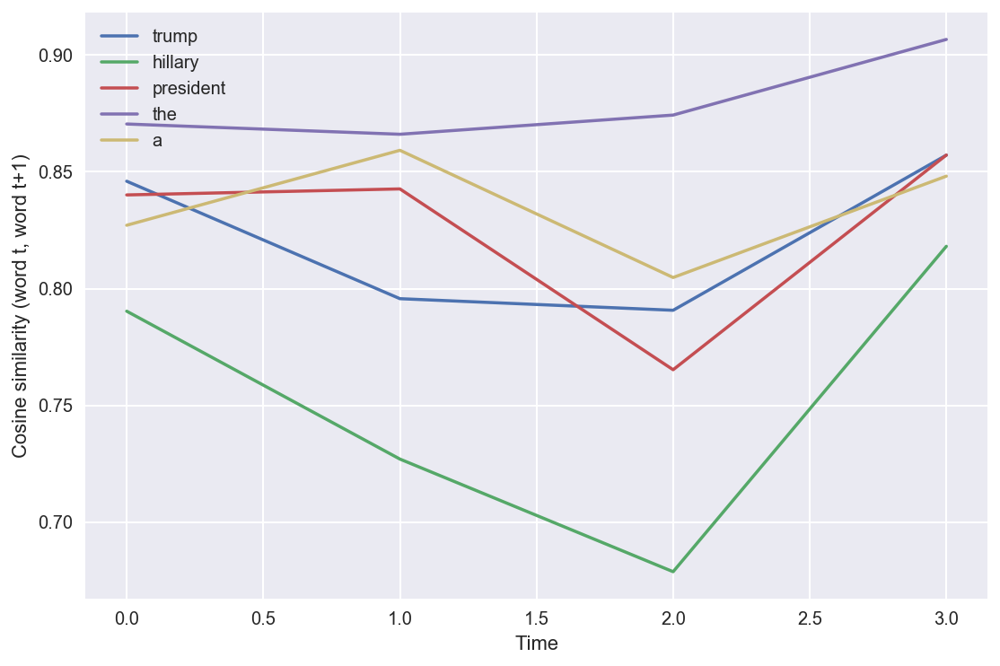

In [183]:
w1=get_meaning_changes(models_final, 'trump')
w2=get_meaning_changes(models_final, 'hillary')
w3=get_meaning_changes(models_final, 'president')
w4=get_meaning_changes(models_final, 'the')
w5=get_meaning_changes(models_final, 'a')
plt.plot([0,1,2,3], w1, label='trump')
plt.plot([0,1,2,3], w2, label='hillary')
plt.plot([0,1,2,3], w3, label='president')
plt.plot([0,1,2,3], w4, label='the')
plt.plot([0,1,2,3], w5, label='a')
plt.legend(loc='upper left')
plt.xlabel('Time')
plt.ylabel('Cosine similarity (word t, word t+1)')

A [recent paper](https://www.aclweb.org/anthology/D17-1119) has found that semantic change in a single word is often biased by word frequency. Further analysis would therefore be required to properly assess these findings.

## Changing meaning between words

Recall that higher values of cosine similarity indicate higher similarity between the words. This indicates that the words are being used more in similar contexts. If the cosine similarity decreases then it indicates that words are being used less in the same context.

In [147]:
def get_similarity_sequence(sequence, word1, word2):
    return [s.similarity(word1, word2) for s in sequence]

### Trump as presidential

In [99]:
a = get_similarity_sequence(models_final, 'trump', 'president')
b = get_similarity_sequence(models_final, 'trump', 'presidental')
c = get_similarity_sequence(models_final, 'trump', 'vote')

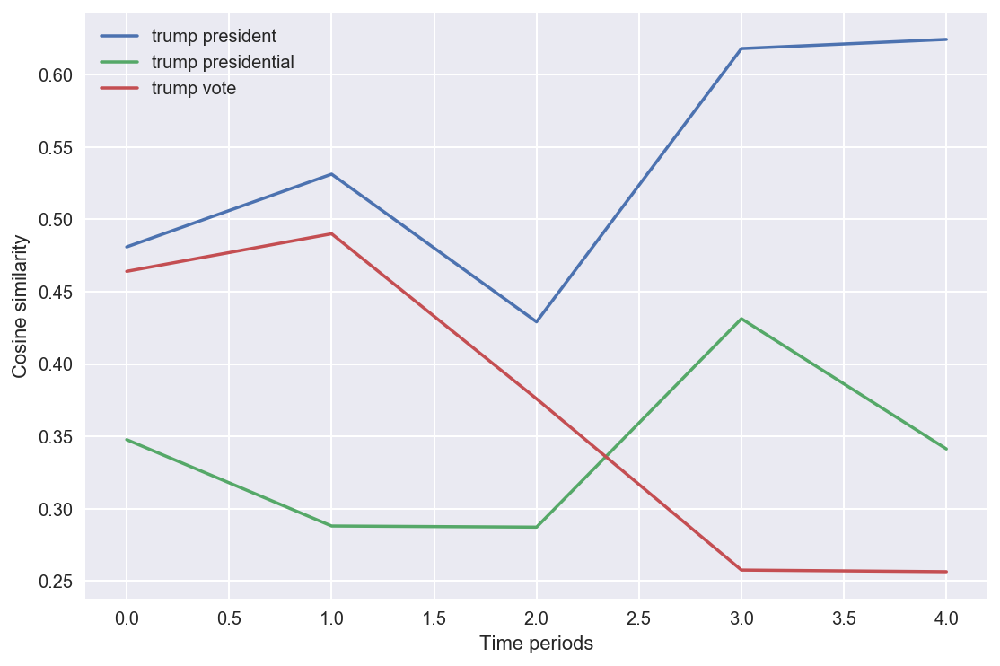

In [114]:
plt.plot([0,1,2,3,4], a, label='trump president')
plt.plot([0,1,2,3,4], b, label='trump presidential')
plt.plot([0,1,2,3,4], c, label='trump vote')
plt.xlabel('Time periods')
plt.ylabel('Cosine similarity')
plt.legend(loc='upper left')

### Trumps attacks on others

In [118]:
h1 = get_similarity_sequence(models_final, 'crooked', 'hillary')
h2 = get_similarity_sequence(models_final, 'emails', 'hillary')
h3 = get_similarity_sequence(models_final, 'benghazi', 'hillary')
h4 = get_similarity_sequence(models_final, 'prison', 'hillary')

In [185]:
ted = get_similarity_sequence(models_final, 'lyin', 'ted')
marco = get_similarity_sequence(models_final, 'little', 'marco')
jeb = get_similarity_sequence(models_final, 'energy', 'jeb')
bernie = get_similarity_sequence(models_final, 'crazy', 'bernie')

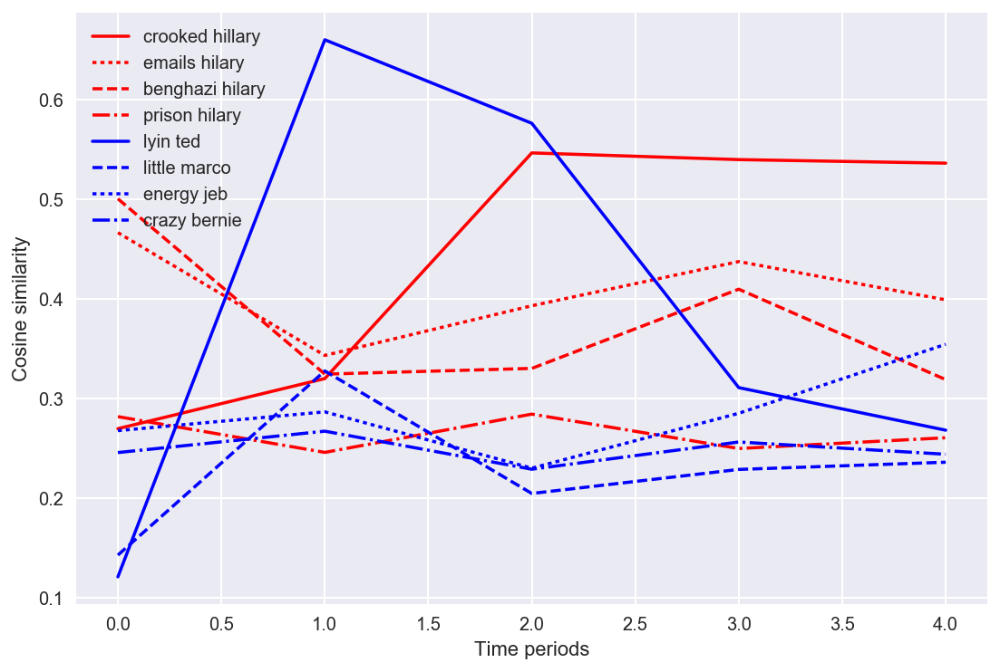

In [186]:
plt.plot([0,1,2,3,4], h1, label='crooked hillary', color='red')
plt.plot([0,1,2,3,4], h2, label='emails hilary', color='red', linestyle=':')
plt.plot([0,1,2,3,4], h3, label='benghazi hilary', color='red', linestyle='--')
plt.plot([0,1,2,3,4], h4, label='prison hilary', color='red', linestyle='-.')
plt.plot([0,1,2,3,4], ted, label='lyin ted', color='blue')
plt.plot([0,1,2,3,4], marco, label='little marco', color='blue', linestyle='--')
plt.plot([0,1,2,3,4], jeb, label='energy jeb', color='blue', linestyle=':')
plt.plot([0,1,2,3,4], bernie, label='crazy bernie', color='blue', linestyle='-.')
plt.xlabel('Time periods')
plt.ylabel('Cosine similarity')
plt.legend(loc='upper left')

### Criticism of Trump

In [128]:
c1 = get_similarity_sequence(models_final, 'trump', 'russia')
c2 = get_similarity_sequence(models_final, 'trump', 'collusion')
c3 = get_similarity_sequence(models_final, 'trump', 'sexist')
c4 = get_similarity_sequence(models_final, 'trump', 'racist')
c5 = get_similarity_sequence(models_final, 'impeach', 'trump')

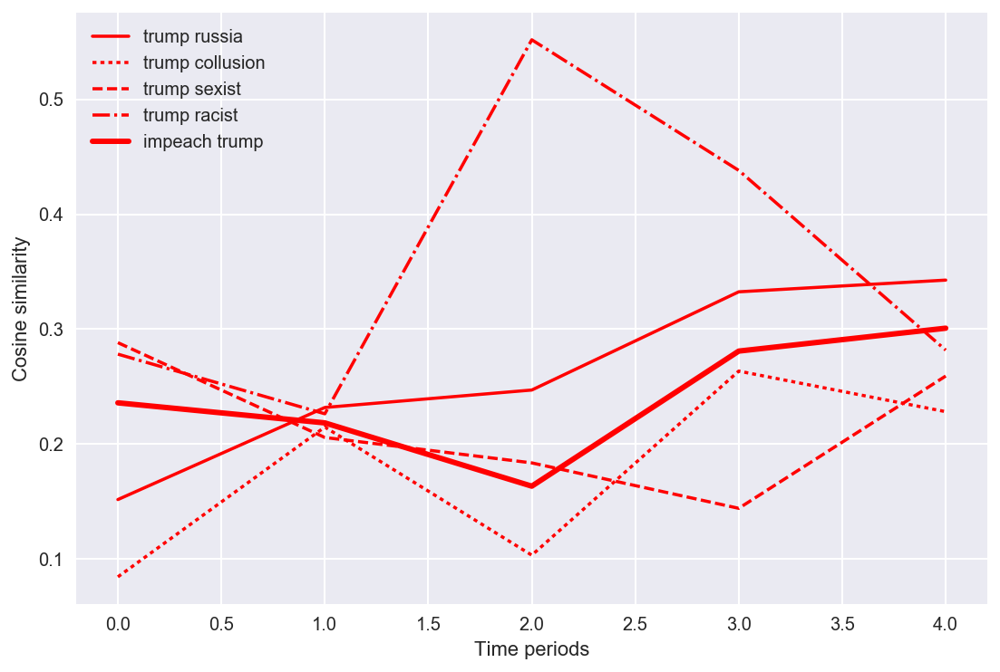

In [133]:
plt.plot([0,1,2,3,4], c1, label='trump russia', color='red')
plt.plot([0,1,2,3,4], c2, label='trump collusion', color='red', linestyle=':')
plt.plot([0,1,2,3,4], c3, label='trump sexist', color='red', linestyle='--')
plt.plot([0,1,2,3,4], c4, label='trump racist', color='red', linestyle='-.')
plt.plot([0,1,2,3,4], c5, label='impeach trump', color='red', linewidth=3.0)
plt.xlabel('Time periods')
plt.ylabel('Cosine similarity')
plt.legend(loc='upper left')

### Trump's policies

In [142]:
p1 = get_similarity_sequence(models_final, 'repeal', 'obamacare')
p2 = get_similarity_sequence(models_final, 'muslim', 'ban')
p3 = get_similarity_sequence(models_final, 'build', 'wall')
p4 = get_similarity_sequence(models_final, 'transgender', 'military')
p5 = get_similarity_sequence(models_final, 'fight', 'isis')
p6 = get_similarity_sequence(models_final, 'cut', 'taxes')

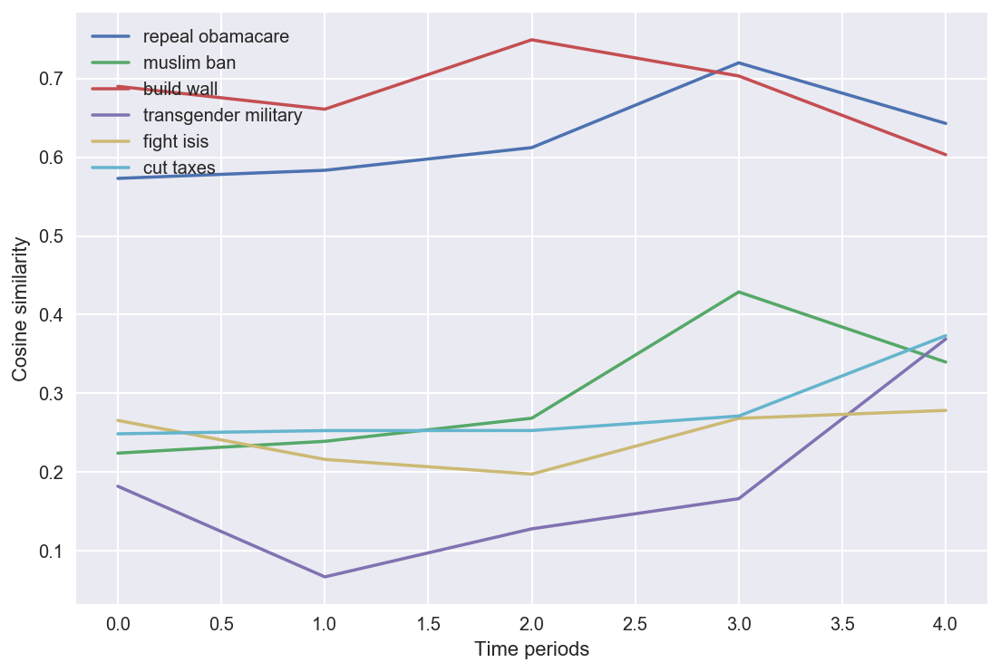

In [143]:
plt.plot([0,1,2,3,4], p1, label='repeal obamacare')
plt.plot([0,1,2,3,4], p2, label='muslim ban')
plt.plot([0,1,2,3,4], p3, label='build wall')
plt.plot([0,1,2,3,4], p4, label='transgender military')
plt.plot([0,1,2,3,4], p5, label='fight isis')
plt.plot([0,1,2,3,4], p6, label='cut taxes')
plt.xlabel('Time periods')
plt.ylabel('Cosine similarity')
plt.legend(loc='upper left')